Power plant energy prediction

In [39]:
import numpy as np 
import pandas as pd

import seaborn as sns

from sklearn.model_selection import train_test_split as tts
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor as rfr
from sklearn.metrics import mean_squared_error as rmse
from sklearn.metrics import make_scorer

In [2]:
data = pd.read_csv('./TRAIN.csv')
test = pd.read_csv('./TEST.csv')

In [3]:
data.head()

,AT,V,AP,RH,PE
0,22.85,60.29,1017.29,61.92,448.58
1,11.75,35.76,1018.99,57.92,473.01
2,12.24,44.90,1020.31,82.22,464.25
3,13.43,40.10,1015.82,87.90,471.77
4,4.65,35.19,1018.23,94.78,489.36


In [4]:
data.isnull().sum()

AT    0
V     0
AP    0
RH    0
PE    0
dtype: int64

In [5]:
data.describe()

,AT,V,AP,RH,PE
count,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000
mean,19.677299,54.302629,1013.235534,73.260478,454.310364
std,7.448395,12.687358,5.920858,14.588452,17.056199
min,2.340000,25.360000,993.110000,25.560000,420.260000
25%,13.510000,41.740000,1009.070000,63.340000,439.727500
50%,20.320000,52.080000,1012.950000,74.880000,451.495000
75%,25.770000,66.540000,1017.190000,84.700000,468.400000
max,37.110000,81.560000,1033.300000,100.160000,495.760000


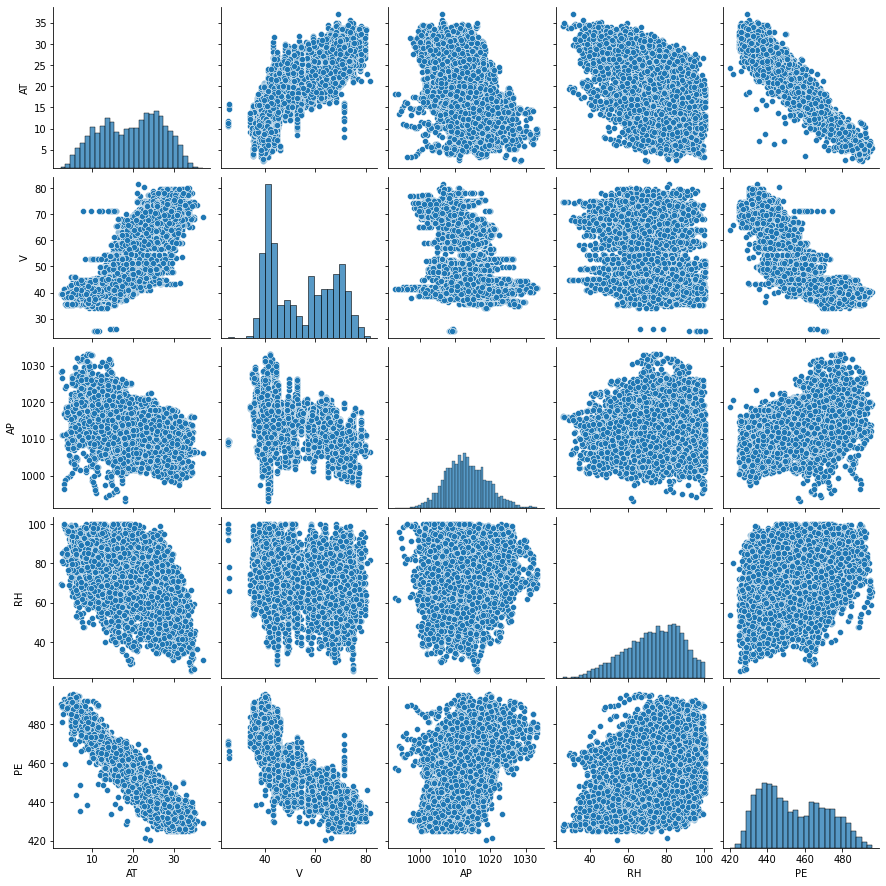

In [6]:
sns.pairplot(data)

In [7]:
X = data[['AT', 'V']]
Y = data['PE']

X_test = test[['AT', 'V']]

In [17]:
clf = make_pipeline(StandardScaler(), rfr(criterion='mse', n_jobs=-1, n_estimators=500, max_features='sqrt'))
clf.fit(X, Y)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('randomforestregressor',
                 RandomForestRegressor(max_features='sqrt', n_estimators=700,
                                       n_jobs=-1))])

In [33]:
params = {  'n_estimators' : [300, 500, 700],
            'max_features' : ['auto', 'sqrt', 'log2']}
mse = make_scorer(rmse,greater_is_better=False)

In [40]:
x_train, x_test, y_train, y_test = tts(X, Y, test_size = 0.25, random_state = 7)

In [41]:
grids = GridSearchCV(rfr(criterion='mse', n_jobs=-1), params, cv=5, n_jobs=-1, verbose=3, scoring=mse)
grids.fit(x_train, y_train)

Fitting 5 folds for each of 12 candidates, totalling 60 fits


GridSearchCV(cv=5, estimator=RandomForestRegressor(n_jobs=-1), n_jobs=-1,
             param_grid={'max_features': ['auto', 'sqrt', 'log2'],
                         'n_estimators': [100, 300, 500, 700]},
             scoring=make_scorer(mean_squared_error, greater_is_better=False),
             verbose=3)

In [36]:
grids.best_params_

{'max_features': 'sqrt', 'n_estimators': 500}

In [42]:
rmse(y_test, grids.predict(x_test), squared=False)

3.8690908045109715

In [ ]:
Y_predict = clf.predict(X_test)

In [ ]:
submissionSVR = pd.DataFrame(Y_predict, columns= ['PE'])
submissionSVR.head()

In [ ]:
submissionSVR.to_csv('./outputSVR.csv', index=True, index_label= 'index')